In [2]:
import cv2
import numpy as np
import matplotlib . pyplot as plt
from mats import pm
# import scipy.ndimage.filters as filters
from scipy.ndimage import maximum_filter
from scipy.spatial import distance

# Harris

In [3]:
def harris(img, size):
    K = 0.05

    sobelx = cv2.Sobel(img, cv2.CV_64F, 1, 0, ksize=size)
    sobely = cv2.Sobel(img, cv2.CV_64F, 0, 1, ksize=size)

    Ixx = cv2.GaussianBlur(sobelx**2, (size, size), 0)
    Iyy = cv2.GaussianBlur(sobely**2, (size, size), 0)
    Ixy = cv2.GaussianBlur(sobelx * sobely, (size, size), 0)

    det = Ixx * Iyy - Ixy**2
    trace = Ixx + Iyy

    H = det - K * trace**2
    H = cv2.normalize(H, None, 0, 1, norm_type=cv2.NORM_MINMAX)
    return H

In [4]:
def find_max(image, size, threshold): # size - maximum filter mask size
    data_max = maximum_filter(image, size)
    maxima = (image==data_max)
    diff = image>threshold
    maxima[diff == 0] = 0 
    return np.nonzero(maxima)

In [5]:
def plot_points(img, x, y):
    plt.figure(figsize=(15, 15))
    plt.imshow(img, cmap="gray")
    plt.plot(y, x, '*', color='r')
    plt.axis("off")
    plt.show()

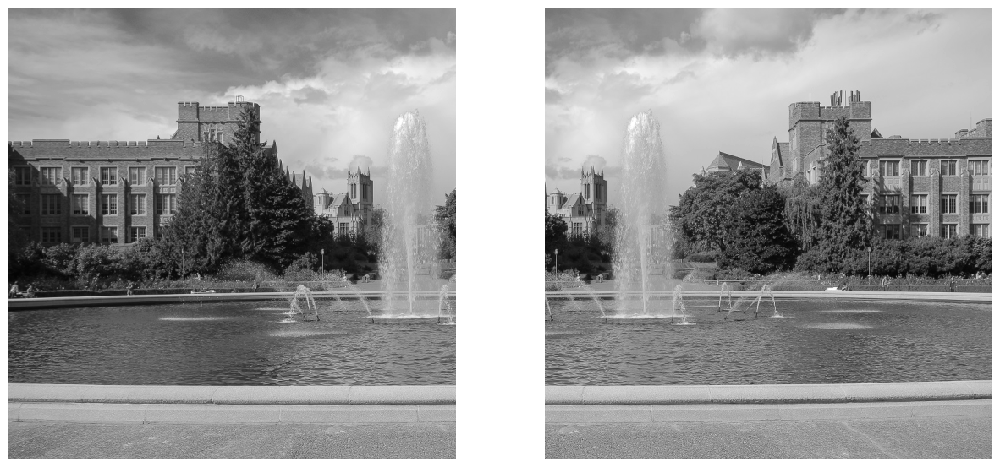

In [6]:
img1 = cv2.imread("mats/fontanna1.jpg", cv2.IMREAD_GRAYSCALE)
img2 = cv2.imread("mats/fontanna2.jpg", cv2.IMREAD_GRAYSCALE)

fig, axs = plt.subplots(1, 2, figsize=(15, 15))
axs[0].imshow(img1, cmap='gray')
axs[0].axis('off')
axs[1].imshow(img2, cmap='gray')
axs[1].axis('off')

plt.show()

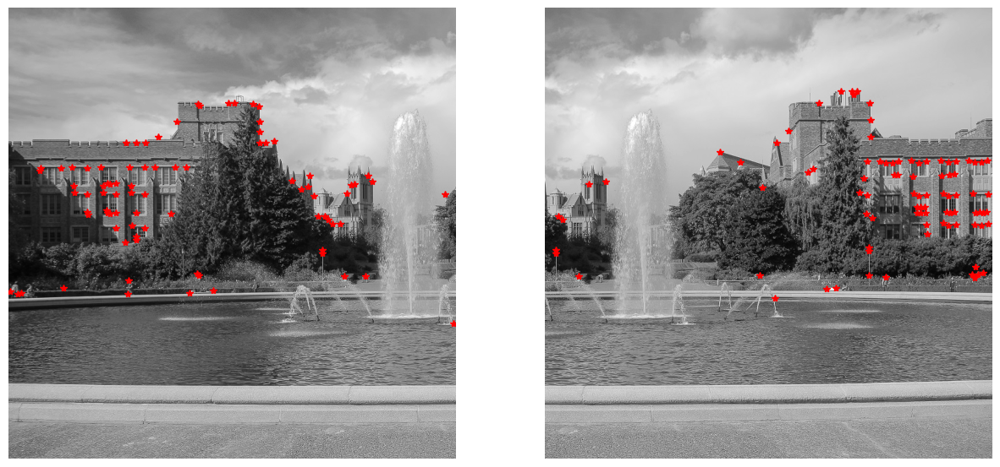

In [7]:
H1 = harris(img1, 7)
H2 = harris(img2, 7)

x1, y1 = find_max(H1, 7, 0.5)
x2, y2 = find_max(H2, 7, 0.5)

fig, axs = plt.subplots(1, 2, figsize=(15, 15))
axs[0].imshow(img1, cmap='gray')
axs[0].plot(y1, x1, '*', color='r')
axs[0].axis('off')

axs[1].imshow(img2, cmap='gray')
axs[1].plot(y2, x2, '*', color='r')
axs[1].axis('off')

plt.show()


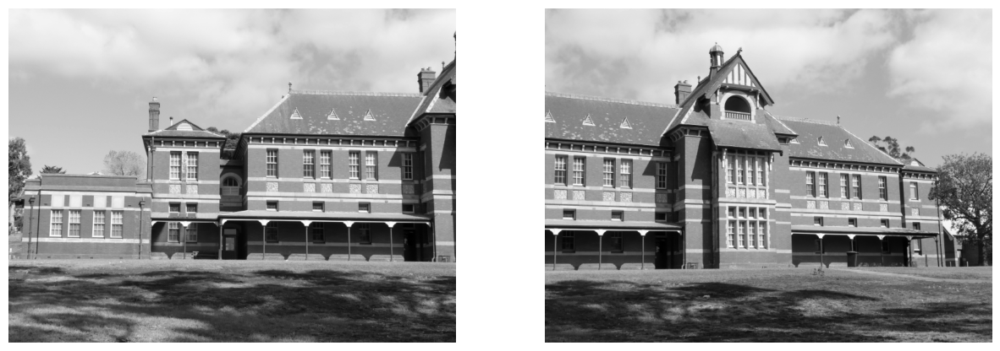

In [8]:
img1 = cv2.imread("mats/budynek1.jpg", cv2.IMREAD_GRAYSCALE)
img2 = cv2.imread("mats/budynek2.jpg", cv2.IMREAD_GRAYSCALE)

fig, axs = plt.subplots(1, 2, figsize=(15, 15))
axs[0].imshow(img1, cmap='gray')
axs[0].axis('off')
axs[1].imshow(img2, cmap='gray')
axs[1].axis('off')

plt.show()

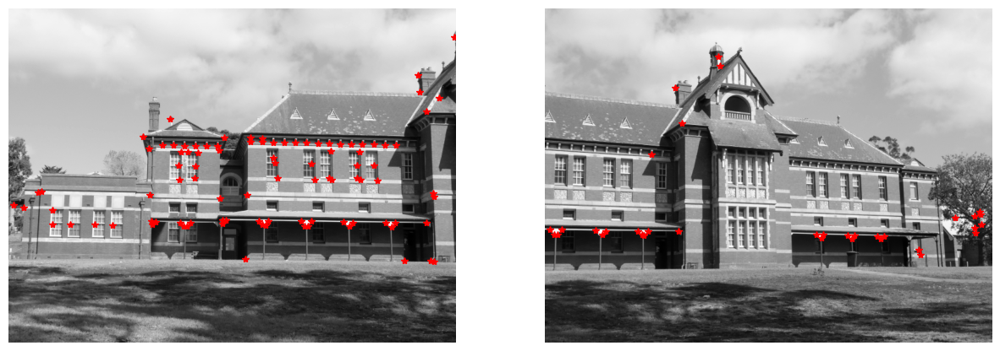

In [9]:
H1 = harris(img1, 7)
H2 = harris(img2, 7)

x1, y1 = find_max(H1, 7, 0.5)
x2, y2 = find_max(H2, 7, 0.5)

fig, axs = plt.subplots(1, 2, figsize=(15, 15))
axs[0].imshow(img1, cmap='gray')
axs[0].plot(y1, x1, '*', color='r')
axs[0].axis('off')

axs[1].imshow(img2, cmap='gray')
axs[1].plot(y2, x2, '*', color='r')
axs[1].axis('off')

plt.show()


# Deskrypcja

In [10]:
def description(img, x, y, size, affin=False):
    Y, X = img.shape
    pts = list(filter(lambda pt: pt[0] >= size and pt[0] < Y-size and pt[1] >= size and pt[1] < X-size, zip(y, x)))
    descriptions = []
    for cy, cx in pts:
        window = img[cy-size:cy+size+1,cx-size:cx+size+1]
        if affin:
            window = (window - np.mean(window)) / np.std(window)          
        descriptions.append(window.flatten())

    return list(zip(pts, descriptions))

In [11]:
def calc_vec_norm(v1, v2):
    return np.linalg.norm(v1 - v2)

def calc_vec_distance(v1, v2):
    return np.sqrt(np.sum((np.square(v1 - v2))))

def calc_scalar_product(v1, v2):
    return np.dot(v1, v2)

In [12]:
def compare_points(neighbourhoods1, neighbourhoods2, n, calc_distance):    
    vec = []
    for vic1 in neighbourhoods1:
        points1, window1 = vic1
        minDistance = float('inf')
        minPoints = (0, 0)
        
        for vic2 in neighbourhoods2:
            points2, window2 = vic2
            distance = calc_distance(window1, window2)
            if distance < minDistance:
                minDistance = distance
                minPoints = points2
        vec.append((minDistance, (points1, minPoints)))

    # sorting by distance
    vec.sort(key = lambda x: x[0])
    res = list(map(lambda x: x[1], vec[:n]))     
    return res  


In [13]:
def appendimages(im1,im2):    
    rows1 = im1.shape[0]    
    rows2 = im2.shape[0]
    
    if rows1 < rows2:
        im1 = np.concatenate((im1,np.zeros((rows2-rows1,im1.shape[1]))),axis=0)
    elif rows1 > rows2:
        im2 = np.concatenate((im2,np.zeros((rows1-rows2,im2.shape[1]))),axis=0)
    
    return np.concatenate((im1,im2), axis=1) 

def plot_matches(im1,im2,matches):
    colors=['r','g','b','c','m','y']
    im3 = appendimages(im1,im2)
    
    plt.figure(figsize=(20, 10))
    plt.imshow(im3, cmap='gray')
    
    cols1 = im1.shape[1]
    for i, m in enumerate(matches):
            plt.plot([m[0][1],m[1][1]+cols1],[m[0][0],m[1][0]],colors[i%6], linewidth=1)
    plt.axis('off') 

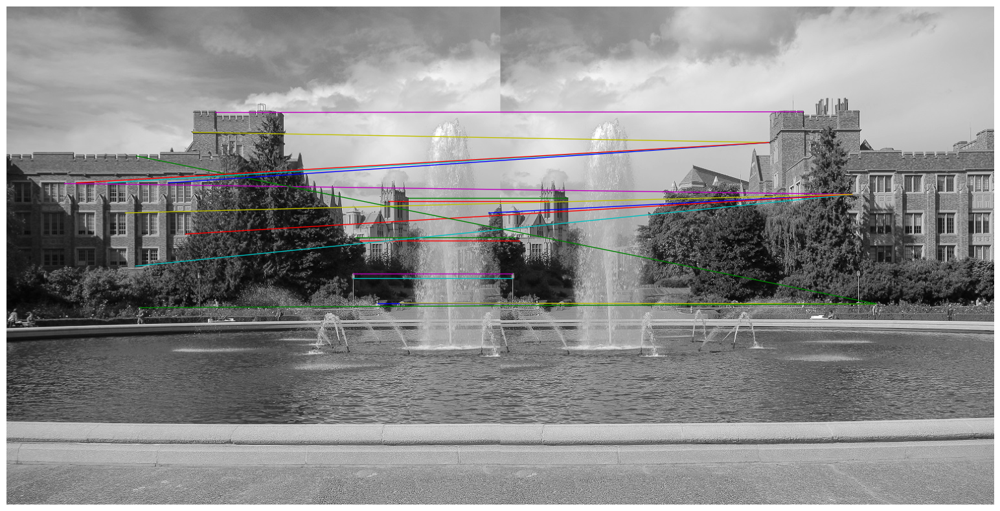

In [14]:
img1 = cv2.imread("mats/fontanna1.jpg", cv2.IMREAD_GRAYSCALE)
img2 = cv2.imread("mats/fontanna2.jpg", cv2.IMREAD_GRAYSCALE)

H1 = harris(img1, 7)
H2 = harris(img2, 7)

y1, x1 = find_max(H1, 7, 0.5)
y2, x2 = find_max(H2, 7, 0.5)

neighbourhoods1 = description(H1, x1, y1, 15)
neighbourhoods2 = description(H2, x2, y2, 15)

n = 20
calc_distance = calc_vec_norm
similar_points = compare_points(neighbourhoods1, neighbourhoods2, n, calc_distance)

plot_matches(img1, img2, similar_points)

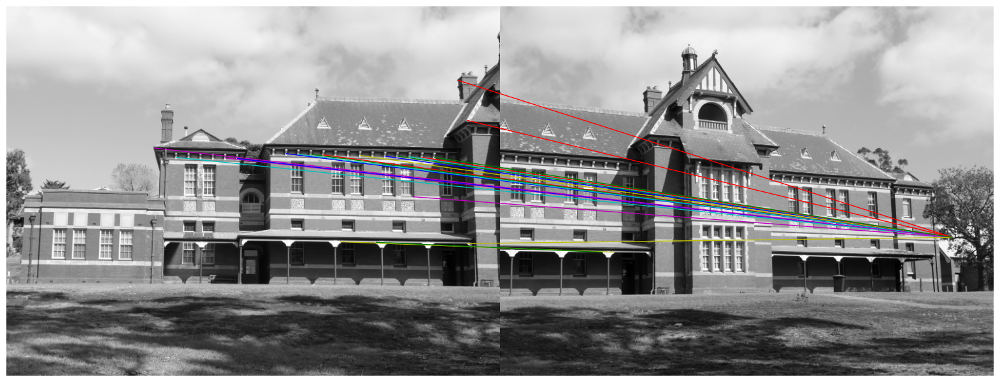

In [34]:
img1 = cv2.imread("mats/budynek1.jpg", cv2.IMREAD_GRAYSCALE)
img2 = cv2.imread("mats/budynek2.jpg", cv2.IMREAD_GRAYSCALE)

H1 = harris(img1, 7)
H2 = harris(img2, 7)

y1, x1 = find_max(H1, 7, 0.6)
y2, x2 = find_max(H2, 7, 0.6)

neighbourhoods1 = description(H1, x1, y1, 15)
neighbourhoods2 = description(H2, x2, y2, 15)

n = 20
calc_distance = calc_vec_norm
similar_points = compare_points(neighbourhoods1, neighbourhoods2, n, calc_distance)

plot_matches(img1, img2, similar_points)

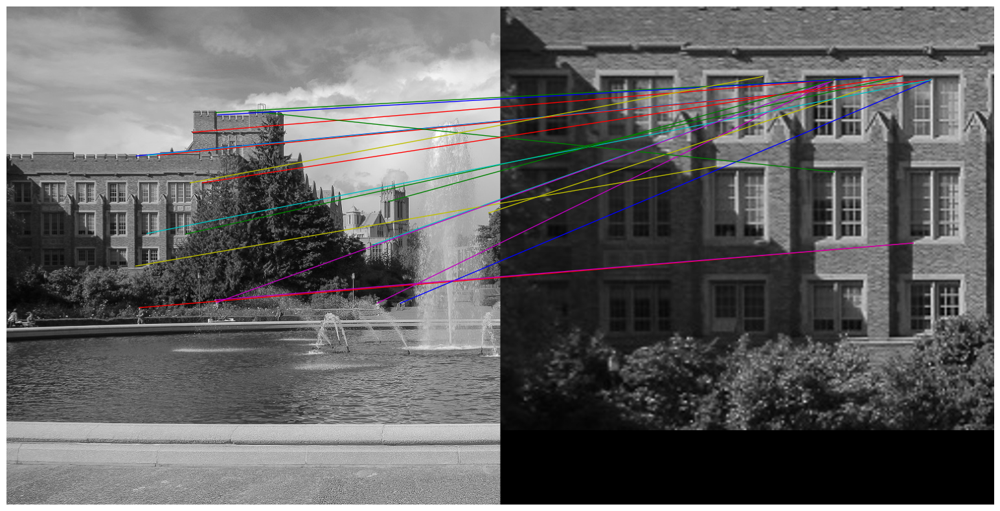

In [16]:
img1 = cv2.imread("mats/fontanna1.jpg", cv2.IMREAD_GRAYSCALE)
img2 = cv2.imread("mats/fontanna_pow.jpg", cv2.IMREAD_GRAYSCALE)

H1 = harris(img1, 7)
H2 = harris(img2, 7)

y1, x1 = find_max(H1, 7, 0.5)
y2, x2 = find_max(H2, 7, 0.5)

neighbourhoods1 = description(H1, x1, y1, 15)
neighbourhoods2 = description(H2, x2, y2, 15)

n = 20
calc_distance = calc_vec_norm
similar_points = compare_points(neighbourhoods1, neighbourhoods2, n, calc_distance)

plot_matches(img1, img2, similar_points)

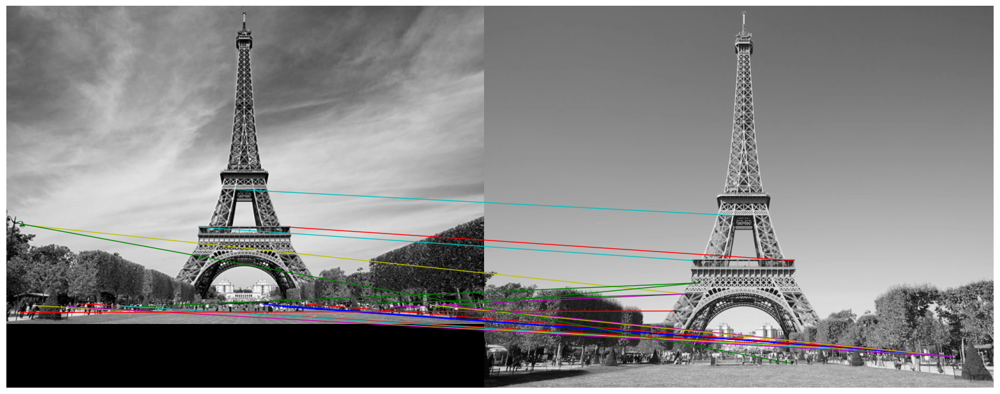

In [17]:
img1 = cv2.imread("mats/eiffel1.jpg", cv2.IMREAD_GRAYSCALE)
img2 = cv2.imread("mats/eiffel2.jpg", cv2.IMREAD_GRAYSCALE)

H1 = harris(img1, 7)
H2 = harris(img2, 7)

y1, x1 = find_max(H1, 7, 0.5)
y2, x2 = find_max(H2, 7, 0.5)

neighbourhoods1 = description(H1, x1, y1, 15)
neighbourhoods2 = description(H2, x2, y2, 15)

n = 20
calc_distance = calc_vec_norm
similar_points = compare_points(neighbourhoods1, neighbourhoods2, n, calc_distance)

plot_matches(img1, img2, similar_points)

## Deskrypcja z afinicznością

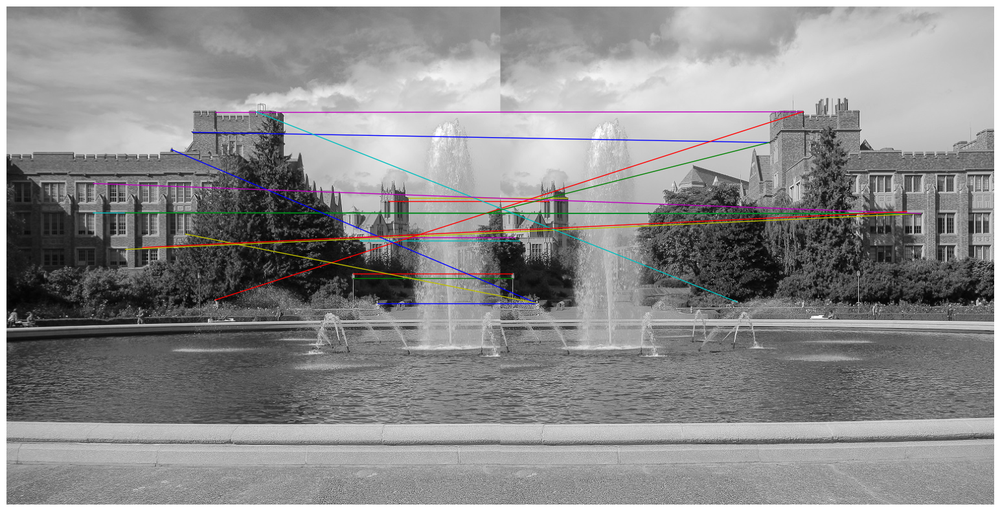

In [18]:
img1 = cv2.imread("mats/fontanna1.jpg", cv2.IMREAD_GRAYSCALE)
img2 = cv2.imread("mats/fontanna2.jpg", cv2.IMREAD_GRAYSCALE)

H1 = harris(img1, 7)
H2 = harris(img2, 7)

y1, x1 = find_max(H1, 7, 0.5)
y2, x2 = find_max(H2, 7, 0.5)

neighbourhoods1 = description(H1, x1, y1, 15, True)
neighbourhoods2 = description(H2, x2, y2, 15, True)

n = 20
calc_distance = calc_vec_norm
similar_points = compare_points(neighbourhoods1, neighbourhoods2, n, calc_distance)

plot_matches(img1, img2, similar_points)

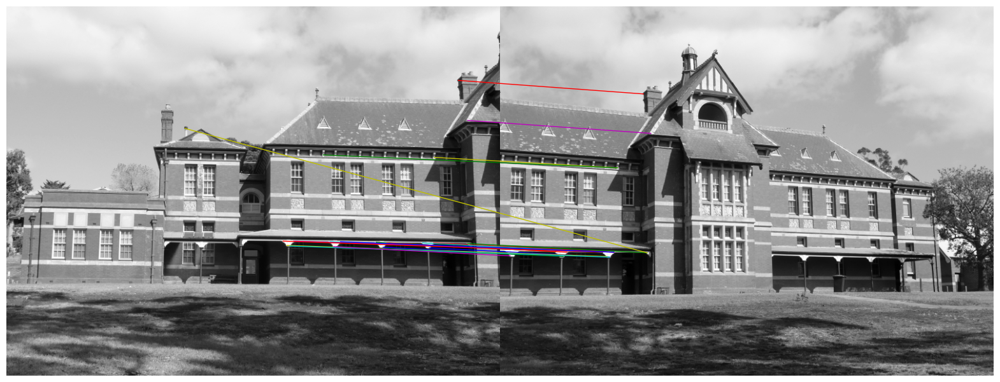

In [19]:
img1 = cv2.imread("mats/budynek1.jpg", cv2.IMREAD_GRAYSCALE)
img2 = cv2.imread("mats/budynek2.jpg", cv2.IMREAD_GRAYSCALE)

H1 = harris(img1, 7)
H2 = harris(img2, 7)

y1, x1 = find_max(H1, 7, 0.5)
y2, x2 = find_max(H2, 7, 0.5)

neighbourhoods1 = description(H1, x1, y1, 15, True)
neighbourhoods2 = description(H2, x2, y2, 15, True)

n = 20
calc_distance = calc_vec_norm
similar_points = compare_points(neighbourhoods1, neighbourhoods2, n, calc_distance)

plot_matches(img1, img2, similar_points)

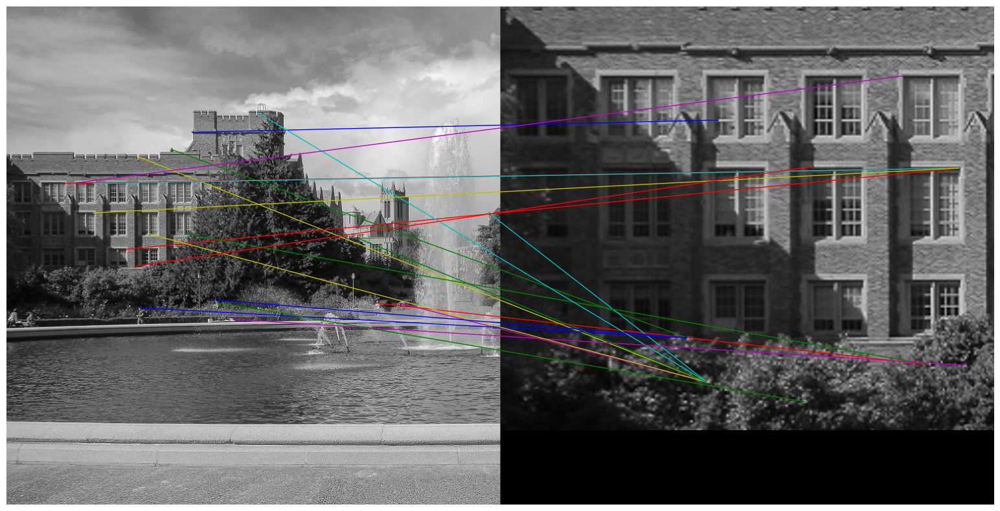

In [20]:
img1 = cv2.imread("mats/fontanna1.jpg", cv2.IMREAD_GRAYSCALE)
img2 = cv2.imread("mats/fontanna_pow.jpg", cv2.IMREAD_GRAYSCALE)

H1 = harris(img1, 7)
H2 = harris(img2, 7)

y1, x1 = find_max(H1, 7, 0.5)
y2, x2 = find_max(H2, 7, 0.5)

neighbourhoods1 = description(H1, x1, y1, 15, True)
neighbourhoods2 = description(H2, x2, y2, 15, True)

n = 20
calc_distance = calc_vec_norm
similar_points = compare_points(neighbourhoods1, neighbourhoods2, n, calc_distance)

plot_matches(img1, img2, similar_points)

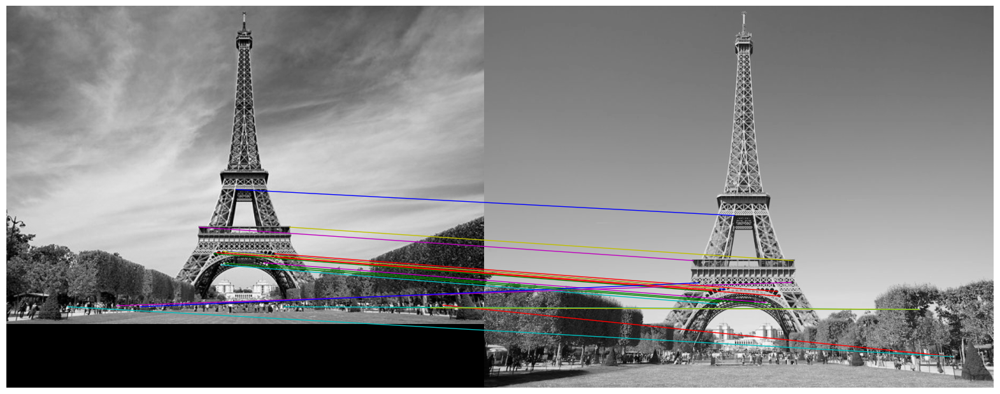

In [21]:
img1 = cv2.imread("mats/eiffel1.jpg", cv2.IMREAD_GRAYSCALE)
img2 = cv2.imread("mats/eiffel2.jpg", cv2.IMREAD_GRAYSCALE)

H1 = harris(img1, 7)
H2 = harris(img2, 7)

y1, x1 = find_max(H1, 7, 0.5)
y2, x2 = find_max(H2, 7, 0.5)

neighbourhoods1 = description(H1, x1, y1, 15, True)
neighbourhoods2 = description(H2, x2, y2, 15, True)

n = 20
calc_distance = calc_vec_norm
similar_points = compare_points(neighbourhoods1, neighbourhoods2, n, calc_distance)

plot_matches(img1, img2, similar_points)

# FAST

In [22]:
def FAST_detector(img, threshold, size=7):
    n_points = 9
    Y, X = img.shape
    pts = [[-3, 0], [-3, 1], [-2, 2], [-1, 3], [0, 3], [1, 3], [2, 2], [3, 1], [3, 0], [3, -1], [2, -2], [1, -3], [0, -3], [-1, -3], [-2, -2], [-3, -1]]

    result = []

    point1 = pts[0]
    point2 = pts[4]
    point3 = pts[8]
    point4 = pts[12]

    def quick_check(x, y):
        pixel = img[y, x]
        lower_bound = pixel - threshold
        upper_bound = pixel + threshold

        pixel1 = img[y + point1[1], x + point1[0]]
        pixel2 = img[y + point2[1], x + point2[0]]
        pixel3 = img[y + point3[1], x + point3[0]]
        pixel4 = img[y + point4[1], x + point4[0]]

        low_count = 0
        high_count = 0
        for p in [pixel1, pixel2, pixel3, pixel4]:
            if p < lower_bound:
                low_count += 1
            elif p > upper_bound:
                high_count += 1
        return low_count >= 2 or high_count >= 2
    
    for y in range(size, Y - size):
        for x in range(size, X - size):
            if not quick_check(x, y):
                continue
            
            low_count = 0
            high_count = 0
            matched = False
            for p in pts:
                pixel = img[y + p[1], x + p[0]]
                if pixel < img[y, x] - threshold:
                    low_count += 1
                    high_count = 0
                elif pixel > img[y, x] + threshold:
                    high_count += 1
                    low_count = 0
                else:
                    high_count = 0
                    low_count = 0
                if low_count >= n_points or high_count >= n_points:
                    matched = True
                    break
            
            if not matched:
                for p in pts[:(n_points-1)]:
                    pixel = img[y + p[1], x + p[0]]
                    if pixel < img[y, x] - threshold:
                        low_count += 1
                        high_count = 0
                    elif pixel > img[y, x] + threshold:
                        high_count += 1
                        low_count = 0
                    else:
                        high_count = 0
                        low_count = 0
                    if low_count >= n_points or high_count >= n_points:
                        matched = True
            if not matched:
                continue
            H = harris(img[y-size:y+size+1, x-size:x+size+1], 7)
            pointHarris = H[size//2, size//2]
            result.append((pointHarris, (y, x)))

    return result


In [23]:
def choose_best_points(points, n):
    points.sort(key = lambda x: x[0], reverse=True)
    return list(map(lambda x: x[1], points[:n]))

In [24]:
def non_maximum_suppresion(points):
    points.sort(key = lambda x: x[0], reverse=True)
    result = []
    for point in points:
        y, x = point[1]
        # check if all of the points in the result are far enough from the current point (no pixels in 3x3 square around)
        is_far_enough = True
        for r in result:
            y1, x1 = r[1]
            if abs(y - y1) <= 1 and abs(x - x1) <= 1:
                if point[0] < r[0]:
                    is_far_enough = False
                else:
                    result.remove(r)
                break
        if is_far_enough:
            result.append(point)
    return result

In [25]:
def remove_border_points(points, img_shape):
    # remove points that are too close to the border (31x31 square around)
    result = []
    for point in points:
        y, x = point[1]
        if y < 15 or y >= img_shape[0] - 15 or x < 15 or x >= img_shape[1] - 15:
            continue
        result.append(point)
    return result

In [26]:
def calculate_moment(img, point, size):
    y, x = point
    window = img[y-size:y+size+1, x-size:x+size+1]
    m00 = np.sum(window)
    m01 = 0
    m10 = 0
    for i in range(-size, size + 1):
        for j in range(-size, size + 1):
            m01 += i * window[i, j]
            m10 += j * window[i, j]

    C = (m01/m00, m10/m00)
    phi = np.arctan2(m01, m10)

    return C, phi

def find_intensity_centroid(img, points, size):
    # find intensity centroid for each point
    result = []
    for point in points:
        y, x = point
        result.append(calculate_moment(img, (y, x), size))
    return result


In [27]:
import math

def brief(img, pt, phi):
    file = open('mats/orb_descriptor_positions.txt', 'r')

    y, x = pt
    vec = []
    size = 15

    window = img[y-size:y+size+1,x-size:x+size+1]
    window = cv2.GaussianBlur(window, (5, 5), 0)

    cos_phi = math.cos(phi)
    sin_phi = math.sin(phi)
    
    for i in range(256):
        content = file.readline()
        dy1, dx1, dy2, dx2 = list(map(float, content.split()))
        dy1 = int(dy1)
        dy2 = int(dy2)
        dx1 = int(dx1)
        dx2 = int(dx2)

        dx1 = int(cos_phi * dx1 - sin_phi * dy1) 
        dy1 = int(sin_phi * dy1 + cos_phi * dx1)

        dx2 = int(cos_phi * dx2 - sin_phi * dy2)
        dy2 = int(sin_phi * dy2 + cos_phi * dx2)
        try:
            pt1 = window[max(min(size + dy1, 2*size),0)][max(min(size + dx1 - 2, 2*size),0)]
            pt2 = window[max(min(size + dy2, 2*size), 0)][max(min(size + dx2, 2*size), 0)]
        except:
            print((max(min(size + dy1, 2*size+1),0), max(min(size + dx1 - 2, 2*size+1),0)), max(min(size + dy2, 2*size+1), 0), max(min(size + dx2, 2*size+1), 0))

        if pt1 < pt2:
            vec.append(1)
        else:
            vec.append(0)

    return vec


def brief_description(img, pts, stats):
    res = []
    
    for i in range(len(pts)):
        y, x = pts[i]
        _, phi = stats[i]
        vec = brief(img, (y, x), phi)
        res.append(vec)
    
    return res


In [28]:
def find_by_hamming_distance(pts1, pts2, vectors1, vectors2, K):
    matchedPairs = []
    
    for i, vec1 in enumerate(vectors1):
        bestScore = float('inf')
        bestFitPoints = (0, 0)
        y1, x1 = pts1[i]

        for j, vec2 in enumerate(vectors2):            
            dist = distance.hamming(vec1, vec2)
            if dist < bestScore:
                y2, x2 = pts2[j]
                bestScore = dist
                bestFitPoints = (y2, x2)
        matchedPairs.append([bestScore, (y1, x1), bestFitPoints])
    matchedPairs.sort(key=lambda el: el[0])
    matchedPairs = matchedPairs[:K]
    return list(map(lambda el: [el[1], el[2]], matchedPairs))


In [29]:
img1 = cv2.imread("mats/fontanna1.jpg", cv2.IMREAD_GRAYSCALE)
img2 = cv2.imread("mats/fontanna2.jpg", cv2.IMREAD_GRAYSCALE)

N = 30

points1 = FAST_detector(img1, 120)
points2 = FAST_detector(img2, 120)

points1 = non_maximum_suppresion(points1)
points2 = non_maximum_suppresion(points2)

points1 = remove_border_points(points1, img1.shape)
points2 = remove_border_points(points2, img2.shape)

points1 = choose_best_points(points1, N)
points2 = choose_best_points(points2, N)

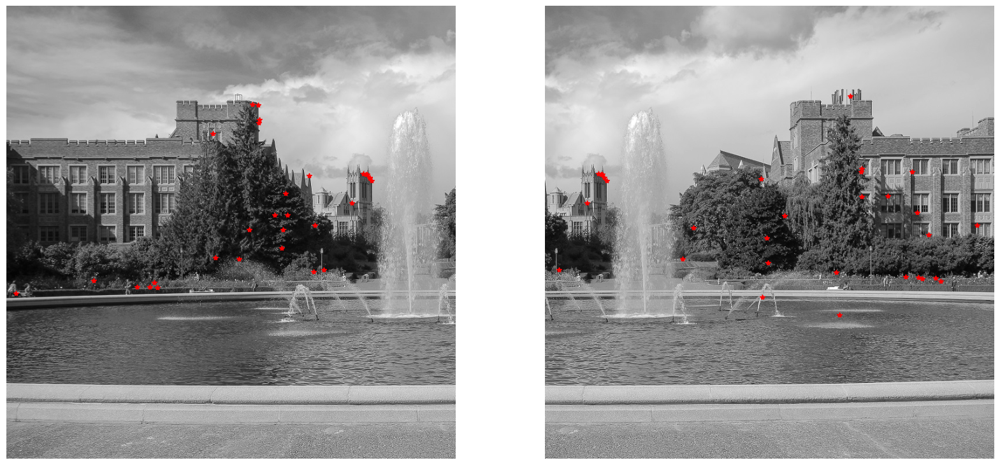

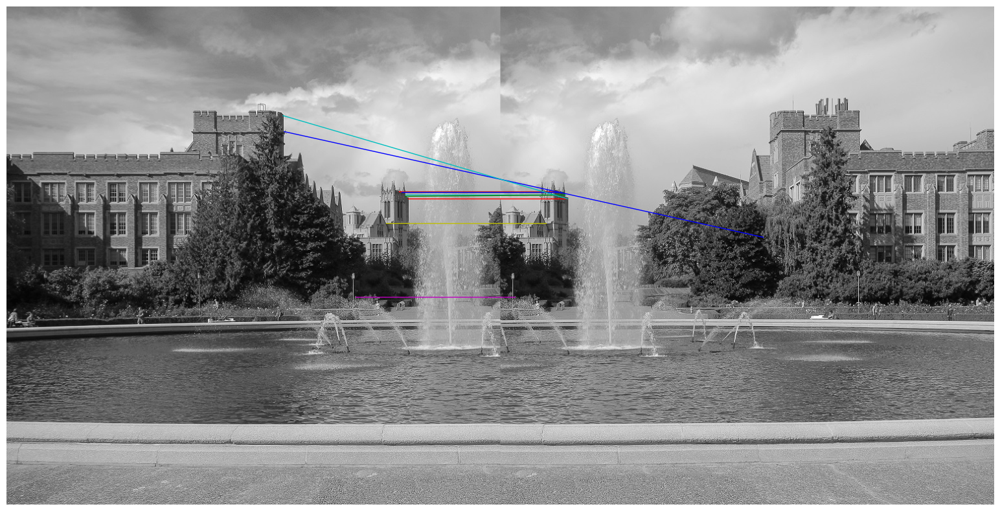

In [30]:
stats1 = find_intensity_centroid(img1, points1, 15)
stats2 = find_intensity_centroid(img2, points2, 15)

vec1 = brief_description(img1, points1, stats1)
vec2 = brief_description(img2, points2, stats2)

matched = find_by_hamming_distance(points1, points2, vec1, vec2, 10)

y1 = list(map(lambda x: x[0], points1))
x1 = list(map(lambda x: x[1], points1))

y2 = list(map(lambda x: x[0], points2))
x2 = list(map(lambda x: x[1], points2))

fig, axs = plt.subplots(1, 2, figsize=(20, 20))

axs[0].imshow(img1, cmap="gray")
axs[0].plot(x1, y1, 'r*')
axs[0].axis("off")

axs[1].imshow(img2, cmap="gray")
axs[1].plot(x2, y2, 'r*')
axs[1].axis("off")

plot_matches(img1, img2, matched)

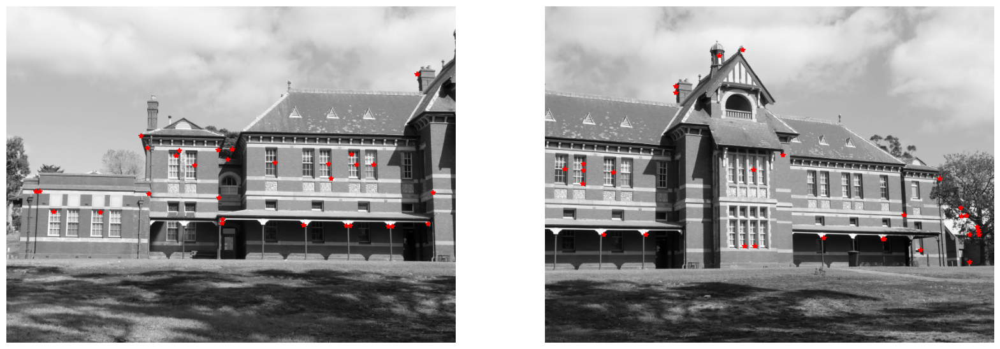

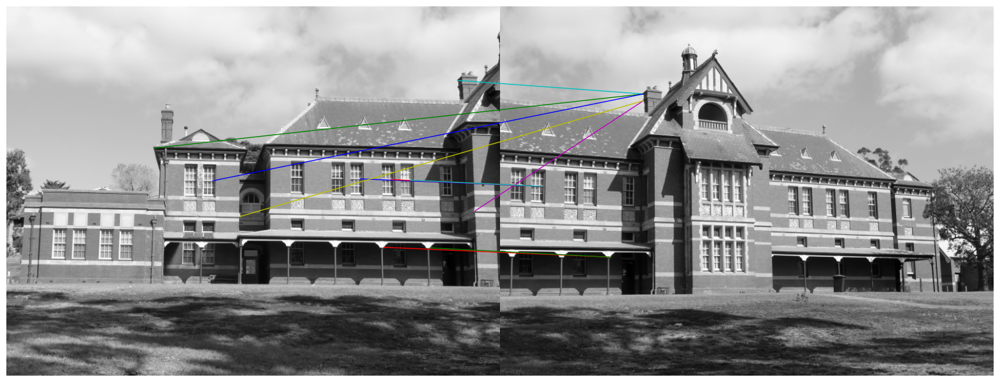

In [31]:
img1 = cv2.imread("mats/budynek1.jpg", cv2.IMREAD_GRAYSCALE)
img2 = cv2.imread("mats/budynek2.jpg", cv2.IMREAD_GRAYSCALE)

N = 30

points1 = FAST_detector(img1, 120)
points2 = FAST_detector(img2, 120)

points1 = non_maximum_suppresion(points1)
points2 = non_maximum_suppresion(points2)

points1 = remove_border_points(points1, img1.shape)
points2 = remove_border_points(points2, img2.shape)

points1 = choose_best_points(points1, N)
points2 = choose_best_points(points2, N)

stats1 = find_intensity_centroid(img1, points1, 15)
stats2 = find_intensity_centroid(img2, points2, 15)

vec1 = brief_description(img1, points1, stats1)
vec2 = brief_description(img2, points2, stats2)

matched = find_by_hamming_distance(points1, points2, vec1, vec2, 10)

y1 = list(map(lambda x: x[0], points1))
x1 = list(map(lambda x: x[1], points1))

y2 = list(map(lambda x: x[0], points2))
x2 = list(map(lambda x: x[1], points2))

fig, axs = plt.subplots(1, 2, figsize=(20, 20))

axs[0].imshow(img1, cmap="gray")
axs[0].plot(x1, y1, 'r*')
axs[0].axis("off")

axs[1].imshow(img2, cmap="gray")
axs[1].plot(x2, y2, 'r*')
axs[1].axis("off")

plot_matches(img1, img2, matched)

# Łączenie zdjęć

(-0.5, 817.5, 709.5, -0.5)

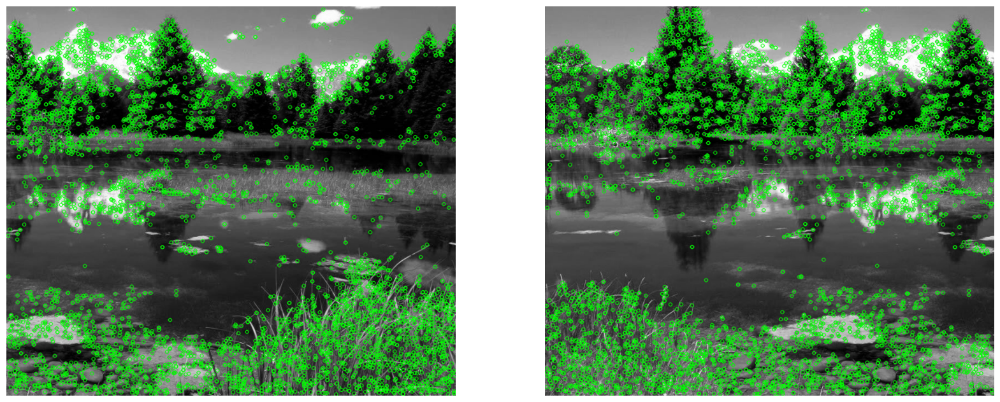

In [32]:
img1 = cv2.imread('mats/left_panorama.jpg', cv2.IMREAD_GRAYSCALE)
img2 = cv2.imread('mats/right_panorama.jpg', cv2.IMREAD_GRAYSCALE)

sift = cv2.SIFT_create(edgeThreshold=6.0)

kp1 = sift.detect(img1)
kp2 = sift.detect(img2)

img1 = cv2.drawKeypoints(img1, kp1, None, color=(0,255,0))
img2 = cv2.drawKeypoints(img2, kp2, None, color=(0,255,0))

fig, axs = plt.subplots(1, 2, figsize=(20, 10))

axs[0].imshow(img1, cmap="gray")
axs[0].axis("off")

axs[1].imshow(img2, cmap="gray")
axs[1].axis("off")


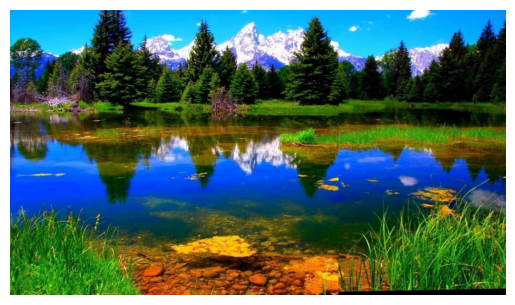

In [33]:
img1 = cv2.imread('mats/left_panorama.jpg', cv2.IMREAD_GRAYSCALE)
img2 = cv2.imread('mats/right_panorama.jpg', cv2.IMREAD_GRAYSCALE)

img1_colored = cv2.imread('mats/left_panorama.jpg')
img2_colored = cv2.imread('mats/right_panorama.jpg')

sift = cv2.SIFT_create()

kp1, des1 = sift.detectAndCompute(img1,None)
kp2, des2 = sift.detectAndCompute(img2,None)

bf = cv2.BFMatcher(cv2.NORM_L2)
matches = bf.knnMatch(des1, des2, k=2)

best_matches = []

for m, n in matches:
    if m.distance < 0.5*n.distance:
        best_matches.append([m])

best_matches = best_matches[:10]

keypointsL = np.float32([kp.pt for kp in kp1])
keypointsR = np.float32([kp.pt for kp in kp2])

ptsA = np.float32([keypointsL[m[0].queryIdx] for m in best_matches])
ptsB = np.float32([keypointsR[m[0].trainIdx] for m in best_matches])

H, _ = cv2.findHomography(ptsA, ptsB)

width = img1.shape[1] + img2.shape[1]
height = max(img1.shape[0], img2.shape[0])

result = cv2.warpPerspective(img1_colored, H, (width, height))
result[0:img2_colored.shape[0], 0:img2_colored.shape[1]] = img2_colored
result = result[:, :1235]

result = cv2.cvtColor(result, cv2.COLOR_BGR2RGB)

plt.imshow(result)
plt.axis("off")
plt.show()
